#### Import libraries

## Gorle Manasa
#### GRIPMAY2021
#### Data Science and Business Analytics
#### Task-4 Exploratory Data Analysis on Terrorism Data

In [1]:
#import all the required libraries
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd 
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import plotly as pl
import plotly.express as px
import plotly.offline as pyo
import cufflinks as cf
from plotly.offline import init_notebook_mode,iplot, plot
from matplotlib.font_manager import FontProperties


In [2]:
pyo.init_notebook_mode(connected=True)
cf.go_offline()

#### Read dataset into the dataframe

In [3]:
#read dataset into the dataframe
gl_terr = pd.read_csv('globalterrorismdb_0718dist.csv')

In [4]:
gl_terr.shape

(181691, 135)

In [5]:
gl_terr.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [61]:
gl_terr.tail()

,year,month,day,approxdate,extended,resolution,country,country,region,region,...,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related,Victims
181686,2017,12,31,NaN,0,NaN,182,Somalia,11,Sub-Saharan Africa,...,"""Somalia: Al-Shabaab Militants Attack Army Che...","""Highlights: Somalia Daily Media Highlights 2 ...","""Highlights: Somalia Daily Media Highlights 1 ...",START Primary Collection,0,0,0,0,NaN,3.0
181687,2017,12,31,NaN,0,NaN,200,Syria,10,Middle East & North Africa,...,"""Putin's 'victory' in Syria has turned into a ...","""Two Russian soldiers killed at Hmeymim base i...","""Two Russian servicemen killed in Syria mortar...",START Primary Collection,-9,-9,1,1,NaN,9.0
181688,2017,12,31,NaN,0,NaN,160,Philippines,5,Southeast Asia,...,"""Maguindanao clashes trap tribe members,"" Phil...",NaN,NaN,START Primary Collection,0,0,0,0,NaN,0.0
181689,2017,12,31,NaN,0,NaN,92,India,6,South Asia,...,"""Trader escapes grenade attack in Imphal,"" Bus...",NaN,NaN,START Primary Collection,-9,-9,0,-9,NaN,0.0
181690,2017,12,31,NaN,0,NaN,160,Philippines,5,Southeast Asia,...,"""Security tightened in Cotabato following IED ...","""Security tightened in Cotabato City,"" Manila ...",NaN,START Primary Collection,-9,-9,0,-9,NaN,0.0


In [7]:
gl_terr.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [8]:
rm = gl_terr.isnull().sum()

In [9]:
rm

eventid            0
iyear              0
imonth             0
iday               0
approxdate    172452
               ...  
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
related       156653
Length: 135, dtype: int64

In [10]:
#check for non null values 
#all these columns has no null values
rm[rm==False]

eventid            0
iyear              0
imonth             0
iday               0
extended           0
country            0
country_txt        0
region             0
region_txt         0
vicinity           0
crit1              0
crit2              0
crit3              0
success            0
suicide            0
attacktype1        0
attacktype1_txt    0
targtype1          0
targtype1_txt      0
gname              0
individual         0
weaptype1          0
weaptype1_txt      0
property           0
dbsource           0
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
dtype: int64

In [11]:
gl_terr.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,...,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,...,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,...,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,...,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000,0.000000,78.000000,5.000000,11.510046,4.545640e+00,1.000000,...,0.000000e+00,0.000000e+00,-9.900000e+01,0.000000,2.000000,-99.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000,0.000000,98.000000,6.000000,31.467463,4.324651e+01,1.000000,...,1.500000e+04,0.000000e+00,0.000000e+00,0.000000,4.000000,0.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000,0.000000,160.000000,10.000000,34.685087,6.871033e+01,1.000000,...,4.000000e+05,0.000000e+00,1.273412e+03,0.000000,7.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,2.017123e+11,2017.000000,12.000000,31.000000,1.000000,1004.000000,12.000000,74.633553,1.793667e+02,5.000000,...,1.000000e+09,1.320000e+08,2.750000e+08,48000.000000,7.000000,2769.000000,1.000000,1.000000,1.000000,1.000000


In [12]:
gl_terr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [13]:
gl_terr['resolution'].isnull().sum()


179471

In [14]:
nn = pd.notnull(gl_terr["resolution"])
gl_terr[nn]

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
112,197003060001,1970,3,6,NaN,1,3/8/1970,83,Guatemala,2,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
123,197003110001,1970,3,11,NaN,1,3/15/1970,30,Brazil,3,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
132,197003140001,1970,3,14,NaN,1,3/31/1970,65,Ethiopia,11,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
135,197003140004,1970,3,14,NaN,1,3/15/1970,217,United States,1,...,McKay and Glatkowski hijacked the ship by deta...,"""Mystery of the SS Columbia Eagle Hijacking,"" ...","Tad Szulc, ""U.S. Arms Ship to Thailand Seized ...","""U. S. Arms Ship, Freed, Leaves Cambodia,"" New...",Hewitt Project,-9,-9,0,-9,NaN
151,197003240002,1970,3,24,NaN,1,3/26/1970,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104210,201111240044,2011,11,23,NaN,1,11/24/2011,92,India,6,...,NaN,"""Naxalites kill two brothers,"" The Times of In...","""Maoists Kill Two in Jharkhand,"" Daiji World, ...",NaN,START Primary Collection,-9,-9,0,-9,NaN
104350,201112010008,2011,12,1,NaN,1,12/2/2011,95,Iraq,10,...,NaN,"""Eight killed in Iraq attacks,"" Agence France ...",NaN,NaN,START Primary Collection,0,0,0,0,NaN
104434,201112050055,2011,12,5,NaN,1,3/23/2013,160,Philippines,5,...,NaN,"Floyd Whaley, ""Kidnapped Australian Is Freed i...","""Philippines policeman arrested over kidnap of...","Belinda Sommer, ""Hostage survivor Warren Rodwe...",UMD Miscellaneous,0,1,1,1,NaN
104486,201112080003,2011,12,8,NaN,1,12/9/2011,4,Afghanistan,6,...,NaN,"""3 killed, 6 injured in suicide bombing in E. ...",NaN,NaN,START Primary Collection,0,0,0,0,NaN


In [15]:
gl_terr["claim2"].isnull().sum()

179801

In [16]:
gl_terr.columns.values

array(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region', 'region_txt',
       'provstate', 'city', 'latitude', 'longitude', 'specificity',
       'vicinity', 'location', 'summary', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'alternative', 'alternative_txt', 'multiple',
       'success', 'suicide', 'attacktype1', 'attacktype1_txt',
       'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt',
       'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt',
       'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2',
       'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2',
       'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt',
       'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3',
       'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2',
       'gname3', 'gsubname3', 'motive', 'guncertain1', 'guncertain2',
       'guncertain3', 'in

## checking for each columns requirment or importance to eliminate columns

In [17]:
gl_terr['hostkidoutcome'].isnull().sum()

170700

In [18]:
rm[rm>176000]

resolution          179471
attacktype3         181263
attacktype3_txt     181263
targtype3           180515
targtype3_txt       180515
targsubtype3        180594
targsubtype3_txt    180594
corp3               180665
target3             180516
natlty3             180544
natlty3_txt         180544
gname2              179678
gsubname2           181531
gname3              181367
gsubname3           181671
guncertain2         179736
guncertain3         181371
claim2              179801
claimmode2          181075
claimmode2_txt      181075
claim3              181373
claimmode3          181558
claimmode3_txt      181558
compclaim           176852
weaptype3           179828
weaptype3_txt       179828
weapsubtype3        179998
weapsubtype3_txt    179998
weaptype4           181618
weaptype4_txt       181618
weapsubtype4        181621
weapsubtype4_txt    181621
nhours              177628
divert              181367
kidhijcountry       178386
ransomamt           180341
ransomamtus         181128
r

In [19]:
gl_terr['vicinity']

0         0
1         0
2         0
3         0
4         0
         ..
181686    0
181687    1
181688    0
181689    0
181690    0
Name: vicinity, Length: 181691, dtype: int64

In [20]:
gl_terr.drop('eventid', inplace = True, axis=1)

In [21]:
gl_terr['nwound'].value_counts()

0.0      103275
1.0       16033
2.0       10219
3.0        7303
4.0        4880
          ...  
197.0         1
245.0         1
211.0         1
800.0         1
600.0         1
Name: nwound, Length: 238, dtype: int64

#### Rename all the columns names as per convenience

In [62]:
gl_terr.rename(columns={'iyear':'year','imonth':'month','city':'city','iday':'day','country_txt':'country',
                        'region_txt':'region','attacktype1_txt':'attack_type',
                        'target1':'target','nkill':'killed','nwound':'wounded','summary':'summary','gname':'group',
                        'targtype1_txt':'target_type',
                        'weaptype1_txt':'weapon_type','motive':'motive'},inplace=True)
gl_terr['Victims'] = gl_terr.killed + gl_terr.wounded

## Create another dataframe with only required columns 

In [23]:
df = gl_terr[['year','month','day','country','region','city','latitude','longitude','attack_type',
              'target_type','weapon_type','killed','wounded','Victims','target','group','suicide','success']]


In [24]:
df.head()

,year,month,day,country,country,region,region,city,latitude,longitude,attack_type,target_type,weapon_type,killed,wounded,Victims,target,group,suicide,success
0,1970,7,2,58,Dominican Republic,2,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,Private Citizens & Property,Unknown,1.0,0.0,1.0,Julio Guzman,MANO-D,0,1
1,1970,0,0,130,Mexico,1,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),Government (Diplomatic),Unknown,0.0,0.0,0.0,"Nadine Chaval, daughter",23rd of September Communist League,0,1
2,1970,1,0,160,Philippines,5,Southeast Asia,Unknown,15.478598,120.599741,Assassination,Journalists & Media,Unknown,1.0,0.0,1.0,Employee,Unknown,0,1
3,1970,1,0,78,Greece,8,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,Government (Diplomatic),Explosives,NaN,NaN,NaN,U.S. Embassy,Unknown,0,1
4,1970,1,0,101,Japan,4,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,Government (Diplomatic),Incendiary,NaN,NaN,NaN,U.S. Consulate,Unknown,0,1


In [25]:
df.shape

(181691, 20)

In [26]:
df.isnull().sum()

year               0
month              0
day                0
country            0
country            0
region             0
region             0
city             434
latitude        4556
longitude       4557
attack_type        0
target_type        0
weapon_type        0
killed         10313
wounded        16311
Victims        16874
target           636
group              0
suicide            0
success            0
dtype: int64

### Total number of People in attack 

In [27]:
df.groupby('Victims').sum()

,year,month,day,country,region,latitude,longitude,killed,wounded,suicide,success
Victims,,,,,,,,,,,
0.0,126622952,407678,979466,8713389,415996,1.411944e+06,1.146787e+06,0.0,0.0,295,49559
1.0,60411562,194632,467292,4081934,216499,6.954118e+05,1.022545e+06,21154.0,9003.0,522,27560
2.0,30634113,99085,236700,1885631,112894,3.585244e+05,5.716022e+05,16590.0,13966.0,306,14338
3.0,20605030,67216,158639,1196672,78242,2.483430e+05,3.881020e+05,15027.0,15792.0,280,9687
4.0,15146285,48925,118725,840965,57696,1.847967e+05,2.960263e+05,14041.0,16155.0,297,7182
...,...,...,...,...,...,...,...,...,...,...,...
1362.0,1996,1,31,186,6,6.941837e+00,7.986169e+01,90.0,1272.0,1,1
1503.0,2016,3,9,95,10,3.530305e+01,4.432993e+01,3.0,1500.0,0,1
4224.0,1998,8,7,104,11,-1.285180e+00,3.682111e+01,224.0,4000.0,1,1


<AxesSubplot:>

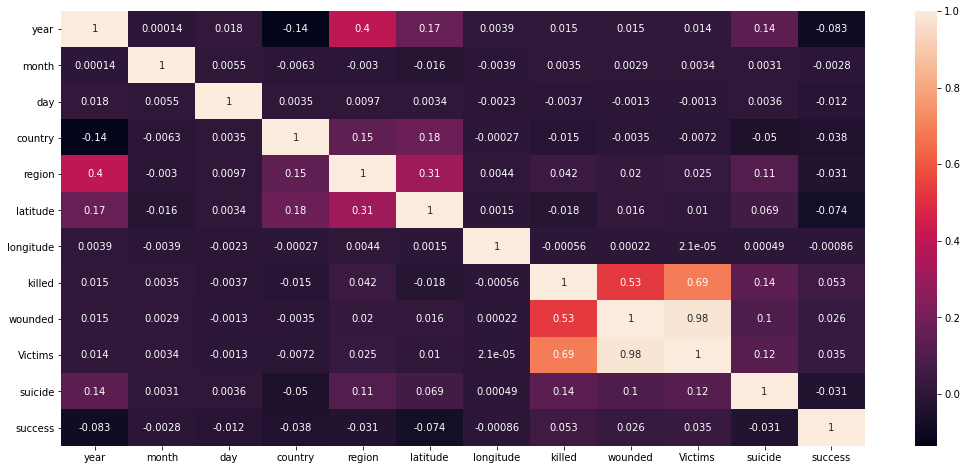

In [28]:
plt.figure(figsize=(18,8))
sns.heatmap(df.corr(), annot= True)

In [29]:
px.scatter(df,x= 'killed',y= 'year')

In [30]:
px.scatter(df, x= 'wounded', y= 'day')

In [31]:
px.scatter(df,x= 'Victims',y= 'year')

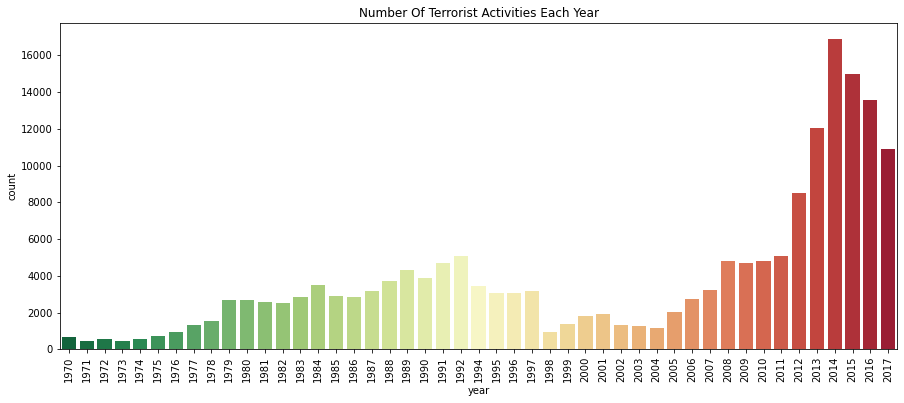

In [32]:
#plotting number of activities every year
plt.subplots(figsize=(15,6))
sns.countplot('year',data=df,palette='RdYlGn_r')
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

<AxesSubplot:xlabel='year'>

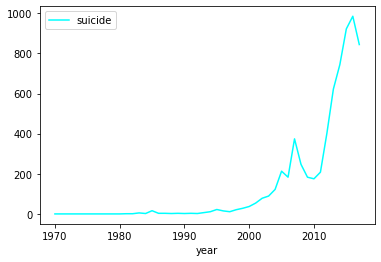

In [33]:
#yearly suicides
df123 = df[['year', 'suicide']].groupby('year').aggregate(np.sum)
df123.plot(color='cyan')


### from the above graph we can say suicide rate is increasing with year

<AxesSubplot:xlabel='month'>

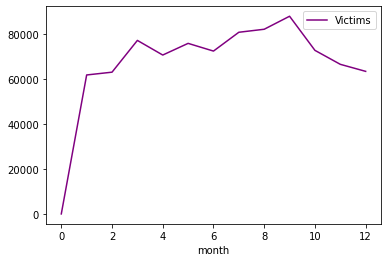

In [34]:
#monthly victims count
df[['month', 'Victims']].groupby('month').aggregate(np.sum).plot(color='purple')


### From the above graph we can say number of victims are more in between february and april

<AxesSubplot:xlabel='year'>

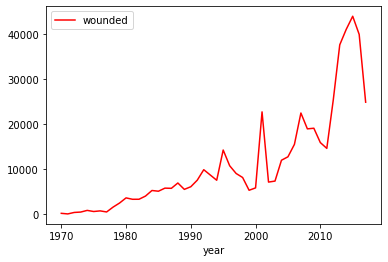

In [35]:
#yearly wounded people count
df[['year', 'wounded']].groupby('year').sum().plot(color='red')

### From the above graph number of people wounded are more in the year 1972 and less in the year 1971

<AxesSubplot:xlabel='day'>

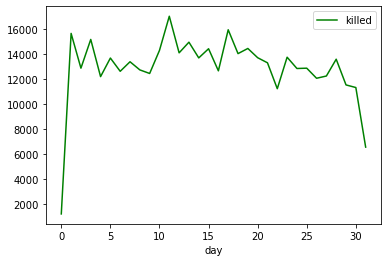

In [36]:
#yearly killed people with aggregate
df[['day', 'killed']].groupby('day').aggregate(np.sum).plot(color='green')

### From above No. of people killed are more from 20th day to 24th day

In [37]:
df['suicide'].nunique()

2

<Figure size 1440x648 with 0 Axes>

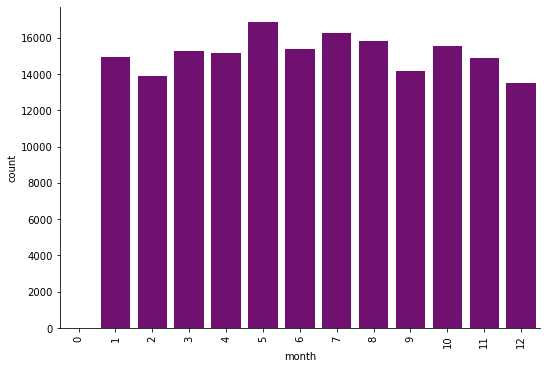

In [38]:
plt.figure(figsize=(20,9))
k= sns.factorplot("month", data=df, aspect=1.5, kind="count", color="purple")
k.set_xticklabels(rotation=90)

In [39]:
df.groupby('year')['Victims'].max()

year
1970      47.0
1971      27.0
1972     132.0
1973     239.0
1974     110.0
1975     127.0
1976     295.0
1977     100.0
1978     422.0
1979     100.0
1980     300.0
1981     383.0
1982     760.0
1983     396.0
1984     751.0
1985     329.0
1986     240.0
1987     458.0
1988     270.0
1989     285.0
1990     187.0
1991     200.0
1992     800.0
1994    1180.0
1995    5513.0
1996    1362.0
1997     498.0
1998    4224.0
1999     300.0
2000     200.0
2001    9574.0
2002     317.0
2003     300.0
2004    1071.0
2005     702.0
2006    1005.0
2007    1000.0
2008    1161.0
2009     654.0
2010     331.0
2011     268.0
2012     427.0
2013     442.0
2014     687.0
2015     536.0
2016    1503.0
2017     910.0
Name: Victims, dtype: float64

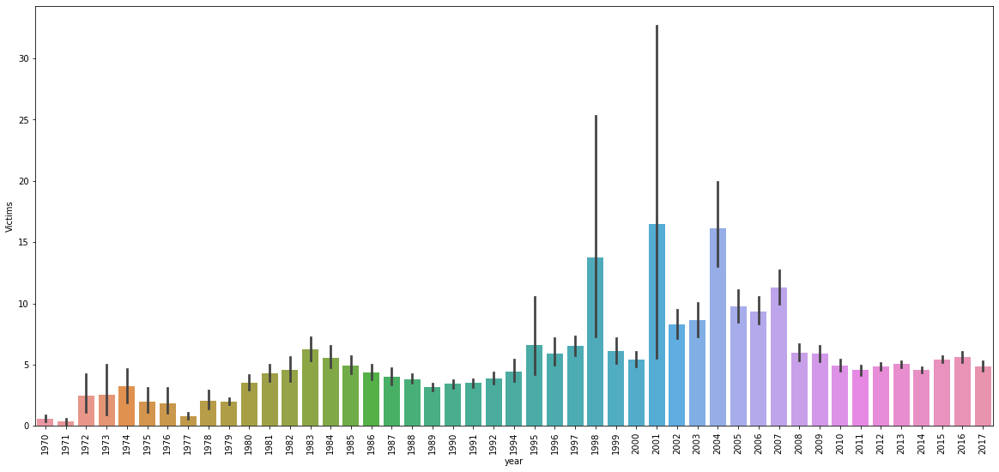

In [40]:
plt.figure(figsize=(20,9))
km=sns.barplot(df['year'], df['Victims'])
plt.xticks(rotation=90)
plt.show()

In [41]:
df.groupby('year')['weapon_type'].max()

year
1970    Vehicle (not to include vehicle-borne explosiv...
1971                                              Unknown
1972                                              Unknown
1973                                              Unknown
1974                                              Unknown
1975                                              Unknown
1976                                              Unknown
1977                                              Unknown
1978                                              Unknown
1979    Vehicle (not to include vehicle-borne explosiv...
1980                                              Unknown
1981                                              Unknown
1982                                              Unknown
1983                                              Unknown
1984    Vehicle (not to include vehicle-borne explosiv...
1985    Vehicle (not to include vehicle-borne explosiv...
1986    Vehicle (not to include vehicle-borne explosiv...
1987    V

In [42]:
df.groupby('year')['weapon_type'].max()

year
1970    Vehicle (not to include vehicle-borne explosiv...
1971                                              Unknown
1972                                              Unknown
1973                                              Unknown
1974                                              Unknown
1975                                              Unknown
1976                                              Unknown
1977                                              Unknown
1978                                              Unknown
1979    Vehicle (not to include vehicle-borne explosiv...
1980                                              Unknown
1981                                              Unknown
1982                                              Unknown
1983                                              Unknown
1984    Vehicle (not to include vehicle-borne explosiv...
1985    Vehicle (not to include vehicle-borne explosiv...
1986    Vehicle (not to include vehicle-borne explosiv...
1987    V

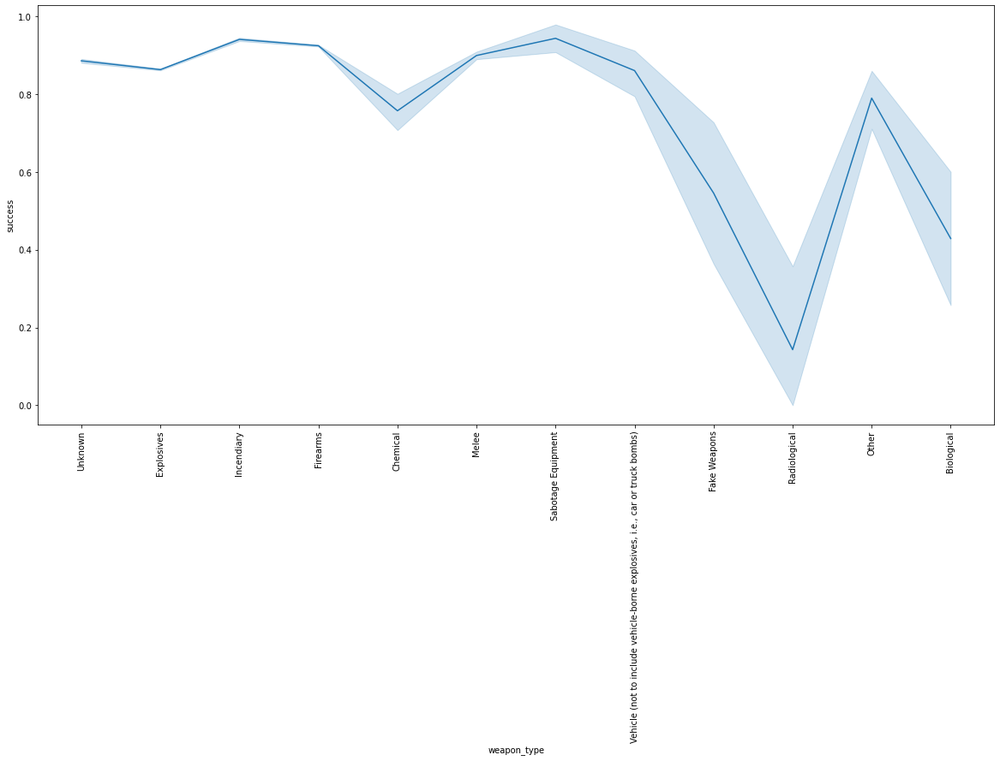

In [43]:
plt.figure(figsize=(20,9))
km=sns.lineplot(df['weapon_type'],df['success'])
plt.xticks(rotation=90)

plt.show()

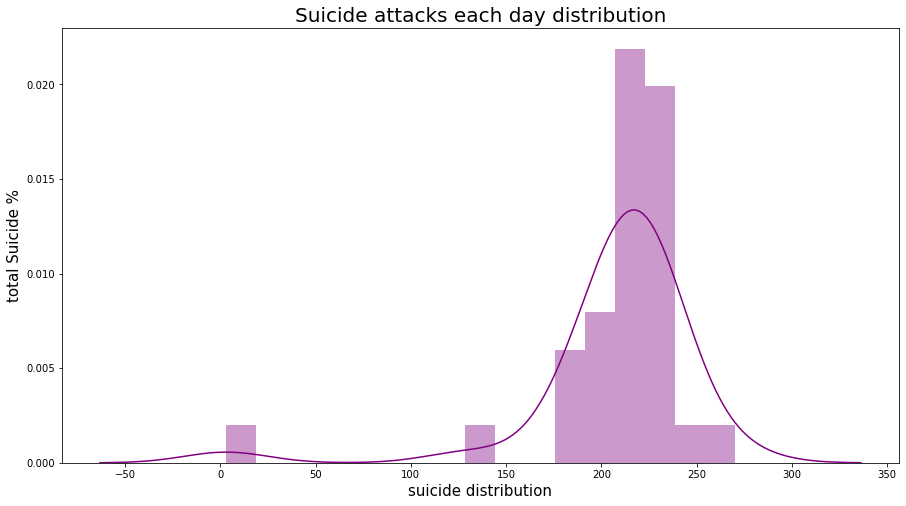

In [44]:
plt.figure(figsize = (15,8))
fig = sns.distplot(df[["day","suicide"]].groupby("day").aggregate(np.sum), color = 'purple')
fig.set_xlabel("suicide distribution",size=15)
fig.set_ylabel("total Suicide %",size=15)
plt.title('Suicide attacks each day distribution',size = 20)
plt.show()

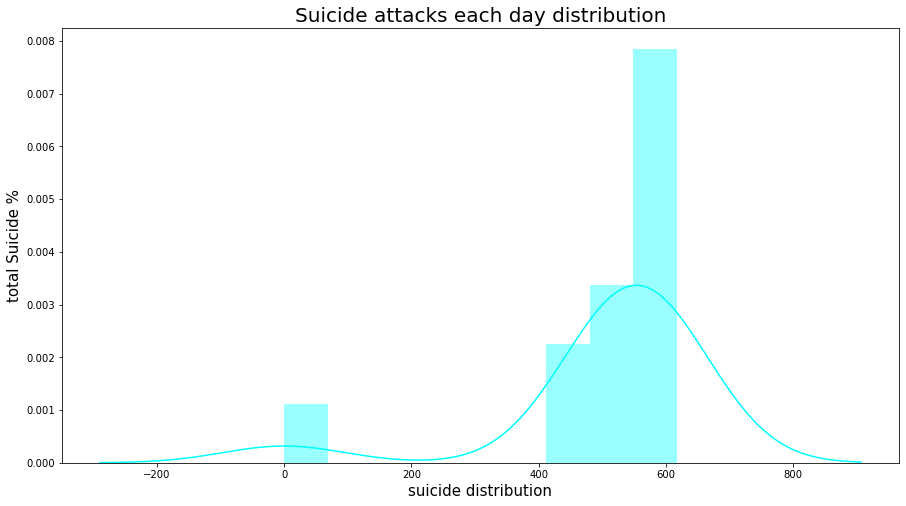

In [45]:
plt.figure(figsize = (15,8))
fig = sns.distplot(df[["month","suicide"]].groupby("month").aggregate(np.sum), color = 'cyan')
fig.set_xlabel("suicide distribution",size=15)
fig.set_ylabel("total Suicide %",size=15)
plt.title('Suicide attacks each day distribution',size = 20)
plt.show()

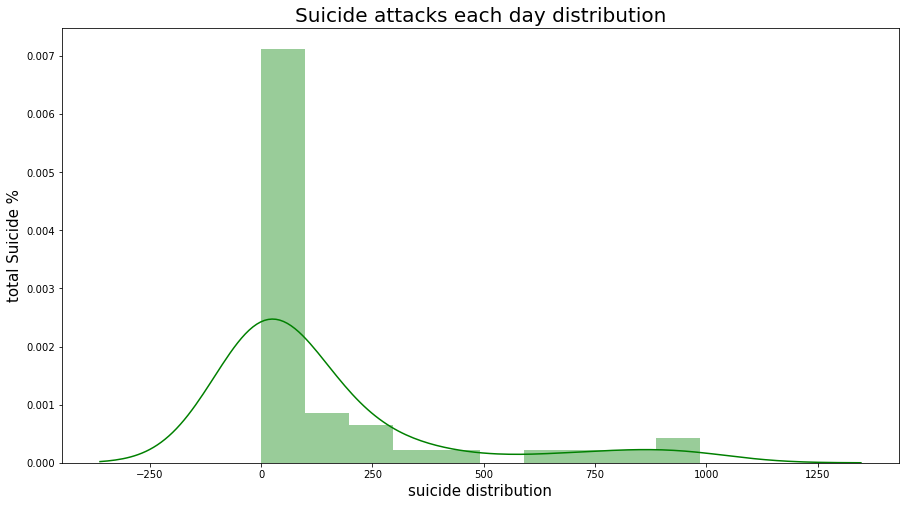

In [46]:
plt.figure(figsize = (15,8))
fig = sns.distplot(df[["year","suicide"]].groupby("year").aggregate(np.sum), color = 'green')
fig.set_xlabel("suicide distribution",size=15)
fig.set_ylabel("total Suicide %",size=15)
plt.title('Suicide attacks each day distribution',size = 20)
plt.show()

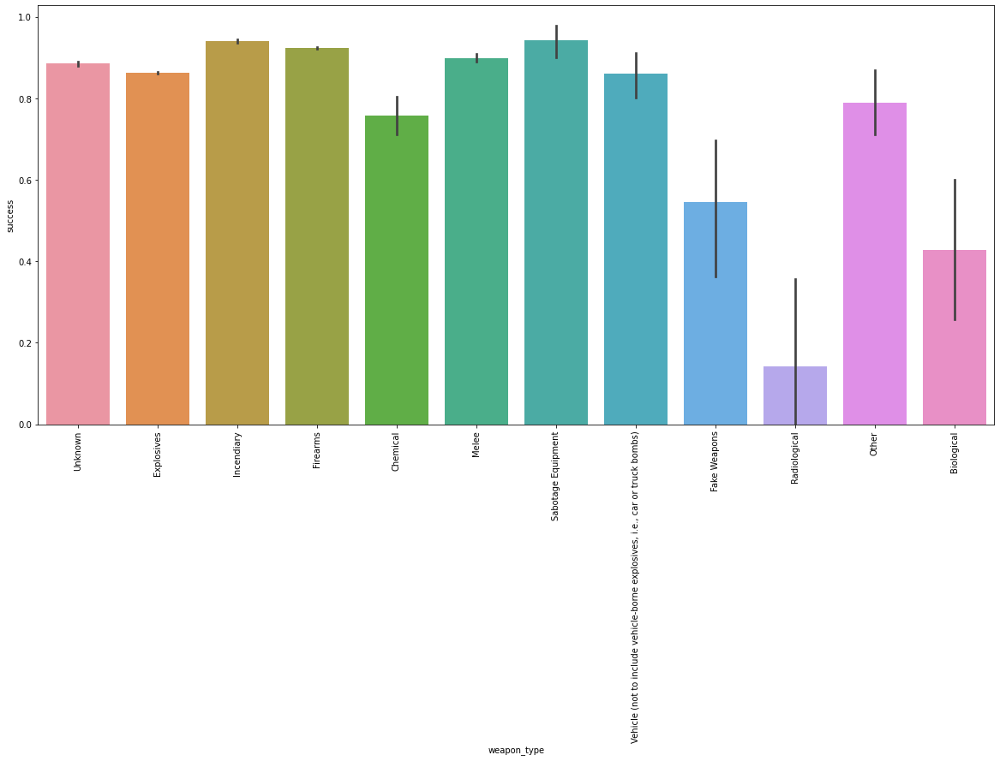

In [47]:
plt.figure(figsize=(20,9))
km=sns.barplot(df['weapon_type'],df['success'])
plt.xticks(rotation=90)

plt.show()

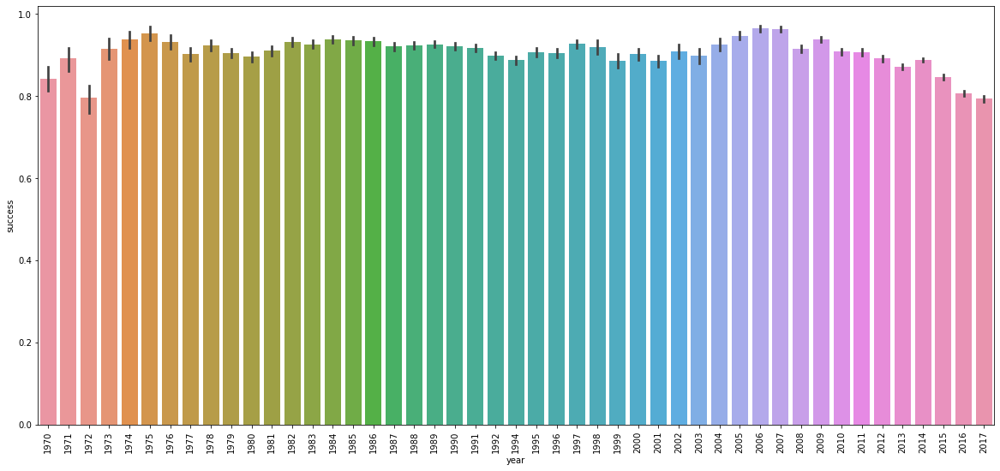

In [48]:
#success bsed on yearly analysis
#year 2006 has more sucess
plt.figure(figsize=(20,9))
km=sns.barplot(df['year'],df['success'])
plt.xticks(rotation=90)

plt.show()

<AxesSubplot:xlabel='suicide', ylabel='count'>

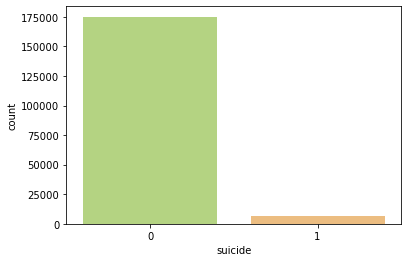

In [49]:
#total suicide cases 
sns.countplot(df['suicide'],data=df,palette='RdYlGn_r')

In [50]:
df.shape

(181691, 20)

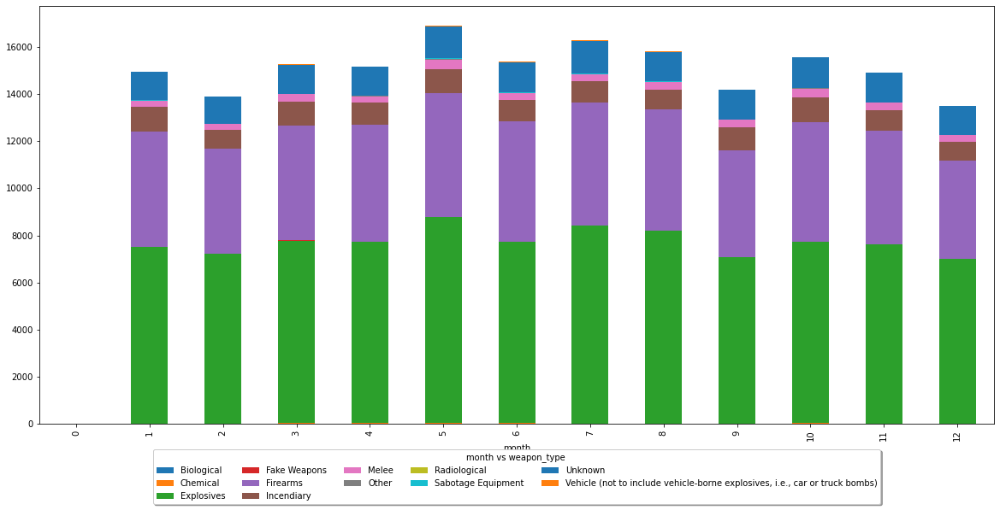

In [52]:
#stacked bars using matplotlib
fontP = FontProperties()
fontP.set_size('xx-small')
sk = pd.crosstab(df.month, df.weapon_type)

sk.plot.bar(stacked = True, figsize = (20,9))
plt.legend(title = 'month vs weapon_type ',loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5)

In [53]:
df.shape

(181691, 20)

In [54]:
df['city'].value_counts()

Unknown                  9775
Baghdad                  7589
Karachi                  2652
Lima                     2359
Mosul                    2265
                         ... 
Saberio                     1
Nantthataung-Chaungwa       1
Trece Martires City         1
Pettigoe                    1
Sidhbari                    1
Name: city, Length: 36674, dtype: int64

In [55]:
ff = df.groupby('city')['Victims'].sum()

ff['Athens']

738.0

###   plot using plotly on map
#### pointing latitude, longitude ad number of people got killed  in a city

In [56]:
geo1 = df.head(3000)
geo1 = geo1[['latitude','longitude','city','Victims']]
px.scatter_geo(geo1, lat='latitude',lon= 'longitude',color='city',hover_name='Victims')

#### pointing latitude, longitude ad number of people got killed  in a city

In [57]:
#plot using lattitude and longitude
geo2 = df.head(3000)
geo2 = geo2[['latitude','longitude','city','wounded']]
px.scatter_geo(geo2, lat='latitude',lon= 'longitude',color='city',hover_name='wounded')

#### pointing latitude, longitude ad number of people got killed  in a city

In [58]:
geo3 = df.head(3000)
geo3 = geo3[['latitude','longitude','city','killed']]
px.scatter_geo(geo3, lat='latitude',lon= 'longitude',color='city',hover_name='killed')

In [59]:
weapon = df['weapon_type'].value_counts()
weapon = pd.DataFrame(weapon).reset_index()
weapon.columns = ['Type_of_weapon','Count']

<AxesSubplot:xlabel='Type_of_weapon'>

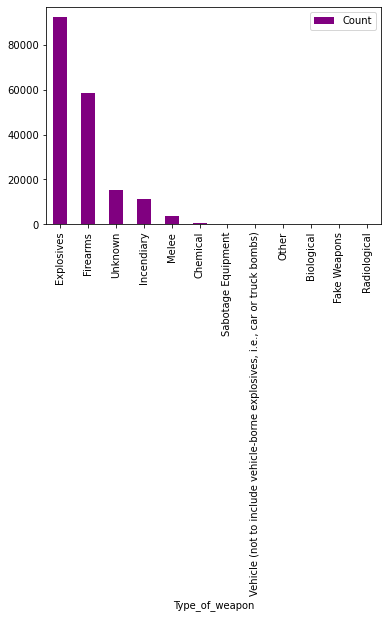

In [60]:
weapon.plot.bar(x='Type_of_weapon',y='Count',rot=90, color='purple')

## Conclusion 

**Based on dataset  the total number of poeple effected are ploted against each other** 

                                ***the basic weopen used for terrorism are sabatage equipment,incendary ranking 1st and 2nd***

**number of victims are more in between february and april during 2001**

**number of people wounded are more in the year 1972 and less in the year 1971**

**No. of people killed are more from 10th day to 15th day**


****



### Thank You!!!!